In [59]:
import numpy as np
import pyvista as pv
import warnings
import skimage
import trimesh
import scipy.ndimage
import matplotlib.pyplot as plt
from scipy.ndimage import distance_transform_edt as edt
from skimage.transform import resize

# Sandpack

In [62]:
# Load the image and reshape it into a 3D array
img = np.fromfile("segmented_lrc32_512.ubc", dtype=np.uint8).reshape((512, 512, 512))

# Slice the image
resized_img = img[:100, :100, :100]  

def sdt(image) -> np.ndarray:
    """
    Returns Signed distance transform map of the input image
    """
    pore = edt(image)
    image = np.invert(image * 255)
    grain = -1 * edt(image)
    sample = grain + pore

    return sample
    
# Plot isosurface on resized image
def plot_isosurface(data, fig: pv.Plotter = None, show_isosurface: list = None, mesh_kwargs: dict = None,
                    plotter_kwargs: dict = None) -> pv.Plotter:
    if mesh_kwargs is None:
        mesh_kwargs = {'opacity': 0.45, 'smooth_shading': True, 'diffuse': 0.75, 'color': (77 / 255, 195 / 255, 255 / 255), 'ambient': 0.15}

    if plotter_kwargs is None:
        plotter_kwargs = {}

    if fig is None:
        fig = pv.Plotter(**plotter_kwargs)

    pv_image_obj = pv.wrap(data)

    if show_isosurface is None:
        show_isosurface = [0]

    contours = pv_image_obj.contour(isosurfaces=show_isosurface, method="marching_cubes")
    fig.add_mesh(contours, **mesh_kwargs)
    return contours, fig

# Compute the signed distance function
resized_img = sdt(resized_img)
# Normalize the signed distance function to [-1, 1]
resized_img = 2 * (resized_img - np.amin(resized_img)) / (np.amax(resized_img) - np.amin(resized_img)) - 1

# Generate the isosurface from the resized image
contour, plotter = plot_isosurface(resized_img, show_isosurface=[0])
# Extract surface and triangulate
mesh = contour.triangulate()

# Extract faces and create Trimesh object
n_faces = mesh.n_cells
faces_as_array = mesh.faces.reshape((n_faces, 4))[:, 1:]
tmesh = trimesh.Trimesh(mesh.points, faces_as_array)

# Visualize with Trimesh
tmesh.show()

In [63]:
# Function to compute mesh quality
def compute_mesh_quality(mesh):
    qualities = {}

    def edge_lengths(elements):
        lengths = []
        for element in elements:
            edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
            lengths.append(edges)
        return np.array(lengths)

    lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # Aspect Ratio: ratio of longest to shortest edge in each element
    aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    qualities['aspect_ratios'] = aspect_ratios

    # Non-Orthogonality: deviation from orthogonal angles in radians
    def non_orthogonality(elements):
        orthogonality = []
        for element in elements:
            element_orthogonality = []
            for i in range(len(element)):
                a = element[i]
                b = element[(i+1) % len(element)]
                c = element[(i+2) % len(element)]
                ba = b - a
                bc = b - c
                angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
                # element_orthogonality.append(np.pi / 2 - angle)
            orthogonality.append(np.pi / 2 - angle)
        return np.array(orthogonality)
    
    qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
    areas = mesh.area_faces
    volume_ratio = areas / np.mean(areas)
    qualities['volume_ratio'] = volume_ratio

    # Using trimesh's face_angles property to calculate angles
    face_angles = mesh.face_angles  # <-- Here is the built-in property usage

    # Convert angles from radians to degrees for skewness calculation
    face_angles_degrees = np.degrees(face_angles)
    
    # Skewness: deviation from ideal angles
    ideal_angle_tri = 60
    skewness_tri = np.max(np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri, axis=1)
    qualities['skewness'] = skewness_tri

    # Tri Max Angle: maximum angle in each triangle
    tri_max_angle = np.max(face_angles_degrees, axis=1)
    qualities['tri_max_angle'] = tri_max_angle

    # Tri Min Angle: minimum angle in each triangle
    tri_min_angle = np.min(face_angles_degrees, axis=1)
    qualities['tri_min_angle'] = tri_min_angle

    return qualities

# Define volume function
def volume(mesh):
    return mesh.volume if mesh.is_volume else 0

# Define non-degenerate faces function
def nondegenerate_faces(mesh, threshold=1e-6):
    return mesh.area_faces > threshold

# Print volume and non-degenerate faces count
print(f"Volume of the mesh: {volume(tmesh)}")
print(f"Number of non-degenerate faces: {np.sum(nondegenerate_faces(tmesh))}")

# Print statistics and overall quality
print(f"Number of elements (triangles): {tmesh.faces.shape[0]}")

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

print(f"Aspect Ratios: min={np.min(quality_metrics['aspect_ratios'])}, max={np.max(quality_metrics['aspect_ratios'])}, mean={np.mean(quality_metrics['aspect_ratios'])}")
print(f"Non-Orthogonality: min={np.min(quality_metrics['non_orthogonality'])}, max={np.max(quality_metrics['non_orthogonality'])}, mean={np.mean(quality_metrics['non_orthogonality'])}")
print(f"Volume Ratio: min={np.min(quality_metrics['volume_ratio'])}, max={np.max(quality_metrics['volume_ratio'])}, mean={np.mean(quality_metrics['volume_ratio'])}")
print(f"Skewness: min={np.min(quality_metrics['skewness'])}, max={np.max(quality_metrics['skewness'])}, mean={np.mean(quality_metrics['skewness'])}")
print(f"Tri Max Angle: min={np.min(quality_metrics['tri_max_angle'])}, max={np.max(quality_metrics['tri_max_angle'])}, mean={np.mean(quality_metrics['tri_max_angle'])}")
print(f"Tri Min Angle: min={np.min(quality_metrics['tri_min_angle'])}, max={np.max(quality_metrics['tri_min_angle'])}, mean={np.mean(quality_metrics['tri_min_angle'])}")

Volume of the mesh: 0
Number of non-degenerate faces: 176168
Number of elements (triangles): 176168
Aspect Ratios: min=1.0, max=6.067748231325822, mean=1.931826517588741
Non-Orthogonality: min=-1.1065180160626698, max=1.4127008172390894, mean=0.5402167842024748
Volume Ratio: min=0.04809701682045342, max=2.1112800651241956, mean=1.0
Skewness: min=2.3684757858670006e-16, max=1.5997961312382027, mean=0.574235629383628
Tri Max Angle: min=60.00000000000001, max=155.98776787429216, mean=93.29581624102849
Tri Min Angle: min=9.05820545751793, max=59.99999999999999, mean=34.60377115490997


In [64]:
# Function to compute statistical metrics
def compute_statistics(quality_array):
    stats = {}
    stats['min'] = np.min(quality_array)
    stats['max'] = np.max(quality_array)
    stats['mean'] = np.mean(quality_array)
    stats['std'] = np.std(quality_array)
    stats['median'] = np.median(quality_array)
    stats['99.9th_percentile'] = np.percentile(quality_array, 99.9)
    return stats

# Compute mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

# Compute statistics for each quality metric
statistics = {metric: compute_statistics(quality_metrics[metric]) for metric in quality_metrics}

# Define an overall mesh quality metric
def overall_quality_metric(stats):
    overall_quality = 0
    for metric in stats:
        overall_quality += 1 / (1 + stats[metric]['mean'] + stats[metric]['std'])
    return overall_quality

overall_quality = overall_quality_metric(statistics)

# Print statistics and overall quality
for metric, stats in statistics.items():
    print(f"{metric.capitalize()}:")
    print(f"  Min: {stats['min']}")
    print(f"  Max: {stats['max']}")
    print(f"  Mean: {stats['mean']}")
    print(f"  Std: {stats['std']}")
    print(f"  Median: {stats['median']}")
    print(f"  99.9th Percentile: {stats['99.9th_percentile']}")
    print()

print(f"Overall Mesh Quality Metric: {overall_quality}")

Aspect_ratios:
  Min: 1.0
  Max: 6.067748231325822
  Mean: 1.931826517588741
  Std: 0.7177123916934355
  Median: 1.6531016682109634
  99.9th Percentile: 5.397731436764886

Non_orthogonality:
  Min: -1.1065180160626698
  Max: 1.4127008172390894
  Mean: 0.5402167842024748
  Std: 0.4987018924212109
  Median: 0.6956349764303917
  99.9th Percentile: 1.3802074564805302

Volume_ratio:
  Min: 0.04809701682045342
  Max: 2.1112800651241956
  Mean: 1.0
  Std: 0.4860440786335764
  Median: 0.9146460936010532
  99.9th Percentile: 1.9404646496319673

Skewness:
  Min: 2.3684757858670006e-16
  Max: 1.5997961312382027
  Mean: 0.574235629383628
  Std: 0.26874797987119514
  Median: 0.5
  99.9th Percentile: 1.3881461845389798

Tri_max_angle:
  Min: 60.00000000000001
  Max: 155.98776787429216
  Mean: 93.29581624102849
  Std: 16.52790877370551
  Median: 90.0
  99.9th Percentile: 143.2887710723388

Tri_min_angle:
  Min: 9.05820545751793
  Max: 59.99999999999999
  Mean: 34.60377115490997
  Std: 12.067702208403

In [65]:
# Plot histograms for each quality metric
#def plot_histograms(quality_metrics):
#    for metric, data in quality_metrics.items():
#        plt.figure()
#        plt.hist(data, bins=30, edgecolor='k', alpha=0.7)
#        plt.title(f"Histogram of {metric.capitalize()}")
#        plt.xlabel(metric.capitalize())
#        plt.ylabel("Frequency")
#        plt.show()

# Call the function to plot histograms
#plot_histograms(quality_metrics)

Overall Mesh Quality Metric: 1.7393074166791096


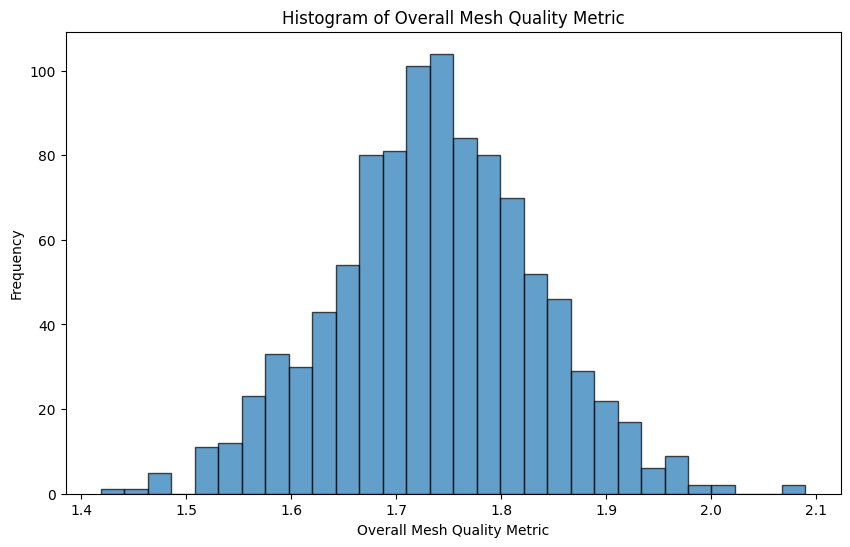

In [66]:


# Function to compute mesh quality
def compute_mesh_quality(mesh):
    qualities = {}

    def edge_lengths(elements):
        lengths = []
        for element in elements:
            edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
            lengths.append(edges)
        return np.array(lengths)

    lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # Aspect Ratio: ratio of longest to shortest edge in each element
    aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    qualities['aspect_ratios'] = aspect_ratios

    # Non-Orthogonality: deviation from orthogonal angles in radians
    def non_orthogonality(elements):
        orthogonality = []
        for element in elements:
            element_orthogonality = []
            for i in range(len(element)):
                a = element[i]
                b = element[(i+1) % len(element)]
                c = element[(i+2) % len(element)]
                ba = b - a
                bc = b - c
                angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
                # element_orthogonality.append(np.pi / 2 - angle)
            orthogonality.append(np.pi / 2 - angle)
        return np.array(orthogonality)
    
    qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
    areas = mesh.area_faces
    volume_ratio = areas / np.mean(areas)
    qualities['volume_ratio'] = volume_ratio

    # Using trimesh's face_angles property to calculate angles
    face_angles = mesh.face_angles  # <-- Here is the built-in property usage

    # Convert angles from radians to degrees for skewness calculation
    face_angles_degrees = np.degrees(face_angles)
    
    # Skewness: deviation from ideal angles
    ideal_angle_tri = 60
    skewness_tri = np.max(np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri, axis=1)
    qualities['skewness'] = skewness_tri

    # Tri Max Angle: maximum angle in each triangle
    tri_max_angle = np.max(face_angles_degrees, axis=1)
    qualities['tri_max_angle'] = tri_max_angle

    # Tri Min Angle: minimum angle in each triangle
    tri_min_angle = np.min(face_angles_degrees, axis=1)
    qualities['tri_min_angle'] = tri_min_angle

    return qualities

# Define volume function
def volume(mesh):
    return mesh.volume if mesh.is_volume else 0

# Define non-degenerate faces function
def nondegenerate_faces(mesh, threshold=1e-6):
    return mesh.area_faces > threshold

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

# Function to compute statistical metrics
def compute_statistics(quality_array):
    stats = {}
    stats['min'] = np.min(quality_array)
    stats['max'] = np.max(quality_array)
    stats['mean'] = np.mean(quality_array)
    stats['std'] = np.std(quality_array)
    stats['median'] = np.median(quality_array)
    stats['99.9th_percentile'] = np.percentile(quality_array, 99.9)
    return stats

# Compute statistics for each quality metric
statistics = {metric: compute_statistics(quality_metrics[metric]) for metric in quality_metrics}

# Define an overall mesh quality metric
def overall_quality_metric(stats):
    overall_quality = 0
    for metric in stats:
        overall_quality += 1 / (1 + stats[metric]['mean'] + stats[metric]['std'])
    return overall_quality

overall_quality = overall_quality_metric(statistics)

# Print the overall mesh quality metric
print(f"Overall Mesh Quality Metric: {overall_quality}")

# Plot histogram for the overall mesh quality metric
def plot_overall_quality_histogram(overall_quality):
    plt.figure(figsize=(10, 6))
    plt.hist(overall_quality, bins=30, edgecolor='k', alpha=0.7)
    plt.title("Histogram of Overall Mesh Quality Metric")
    plt.xlabel("Overall Mesh Quality Metric")
    plt.ylabel("Frequency")
    plt.show()

# Simulate a distribution of the overall quality metric
overall_quality_samples = np.random.normal(overall_quality, 0.1, 1000)

# Call the function to plot the histogram
plot_overall_quality_histogram(overall_quality_samples)


# Castlegate

In [68]:
# Load the image and reshape it into a 3D array
img = np.fromfile("segmented_castle_512.ubc", dtype=np.uint8).reshape((512, 512, 512))

# Slice the image
resized_img = img[:100, :100, :100]  

# def sdt(image) -> np.ndarray:
#     """
#     Returns Signed distance transform map of the input image
#     """
#     pore = edt(image)
#     image = np.invert(image * 255)
#     grain = -1 * edt(image)
#     sample = grain + pore

#     return sample
    
# # Plot isosurface on resized image
# def plot_isosurface(data, fig: pv.Plotter = None, show_isosurface: list = None, mesh_kwargs: dict = None,
#                     plotter_kwargs: dict = None) -> pv.Plotter:
#     if mesh_kwargs is None:
#         mesh_kwargs = {'opacity': 0.45, 'smooth_shading': True, 'diffuse': 0.75, 'color': (77 / 255, 195 / 255, 255 / 255), 'ambient': 0.15}

#     if plotter_kwargs is None:
#         plotter_kwargs = {}

#     if fig is None:
#         fig = pv.Plotter(**plotter_kwargs)

#     pv_image_obj = pv.wrap(data)

#     if show_isosurface is None:
#         show_isosurface = [0]

#     contours = pv_image_obj.contour(isosurfaces=show_isosurface)
#     fig.add_mesh(contours, **mesh_kwargs)
#     return contours, fig
    
resized_img = sdt(resized_img)
resized_img = 2 * (resized_img - np.amin(resized_img)) / (np.amax(resized_img) - np.amin(resized_img)) - 1

# Generate the isosurface from the resized image
contour, plotter = plot_isosurface(resized_img, show_isosurface=[0])

# Extract surface and triangulate
mesh = contour.extract_surface().triangulate()

# Extract faces and create Trimesh object
n_faces = mesh.n_cells
faces_as_array = mesh.faces.reshape((n_faces, 4))[:, 1:]
tmesh = trimesh.Trimesh(mesh.points, faces_as_array)

# Visualize with Trimesh
tmesh.show()

In [69]:
# Function to compute mesh quality
# def compute_mesh_quality(mesh):
#     qualities = {}

    # def edge_lengths(elements):
    #     lengths = []
    #     for element in elements:
    #         edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
    #         lengths.append(edges)
    #     return np.array(lengths)

    # lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # # Aspect Ratio: ratio of longest to shortest edge in each element
    # aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    # qualities['aspect_ratios'] = aspect_ratios

    # # Non-Orthogonality: deviation from orthogonal angles in radians
    # def non_orthogonality(elements):
    #     orthogonality = []
    #     for element in elements:
    #         element_orthogonality = []
    #         for i in range(len(element)):
    #             a = element[i]
    #             b = element[(i+1) % len(element)]
    #             c = element[(i+2) % len(element)]
    #             ba = b - a
    #             bc = b - c
    #             angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
    #             element_orthogonality.append(np.pi / 2 - angle)
    #         orthogonality.append(element_orthogonality)
    #     return np.array(orthogonality)
    
    # qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
#     areas = mesh.area_faces
#     volume_ratio = areas / np.mean(areas)
#     qualities['volume_ratio'] = volume_ratio

#     # Using trimesh's face_angles property to calculate angles
#     face_angles = mesh.face_angles  # <-- Here is the built-in property usage

#     # Convert angles from radians to degrees for skewness calculation
#     face_angles_degrees = np.degrees(face_angles)
    
#     # Skewness: deviation from ideal angles
#     ideal_angle_tri = 60
#     skewness_tri = np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri
#     qualities['skewness'] = skewness_tri

#     # Tri Max Angle: maximum angle in each triangle
#     tri_max_angle = np.max(face_angles_degrees, axis=1)
#     qualities['tri_max_angle'] = tri_max_angle

#     # Tri Min Angle: minimum angle in each triangle
#     tri_min_angle = np.min(face_angles_degrees, axis=1)
#     qualities['tri_min_angle'] = tri_min_angle

#     return qualities

# # Define volume function
# def volume(mesh):
#     return mesh.volume if mesh.is_volume else 0

# # Define non-degenerate faces function
# def nondegenerate_faces(mesh, threshold=1e-6):
#     return mesh.area_faces > threshold

# Print volume and non-degenerate faces count
print(f"Volume of the mesh: {volume(tmesh)}")
print(f"Number of non-degenerate faces: {np.sum(nondegenerate_faces(tmesh))}")

# Print statistics and overall quality
print(f"Number of elements (triangles): {tmesh.faces.shape[0]}")

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

print(f"Aspect Ratios: min={np.min(quality_metrics['aspect_ratios'])}, max={np.max(quality_metrics['aspect_ratios'])}, mean={np.mean(quality_metrics['aspect_ratios'])}")
print(f"Non-Orthogonality: min={np.min(quality_metrics['non_orthogonality'])}, max={np.max(quality_metrics['non_orthogonality'])}, mean={np.mean(quality_metrics['non_orthogonality'])}")
print(f"Volume Ratio: min={np.min(quality_metrics['volume_ratio'])}, max={np.max(quality_metrics['volume_ratio'])}, mean={np.mean(quality_metrics['volume_ratio'])}")
print(f"Skewness: min={np.min(quality_metrics['skewness'])}, max={np.max(quality_metrics['skewness'])}, mean={np.mean(quality_metrics['skewness'])}")
print(f"Tri Max Angle: min={np.min(quality_metrics['tri_max_angle'])}, max={np.max(quality_metrics['tri_max_angle'])}, mean={np.mean(quality_metrics['tri_max_angle'])}")
print(f"Tri Min Angle: min={np.min(quality_metrics['tri_min_angle'])}, max={np.max(quality_metrics['tri_min_angle'])}, mean={np.mean(quality_metrics['tri_min_angle'])}")

Volume of the mesh: 0
Number of non-degenerate faces: 270004
Number of elements (triangles): 270004
Aspect Ratios: min=1.0, max=68.12390076127201, mean=6.225655420363275
Non-Orthogonality: min=-1.3483009627674893, max=1.5565483674016534, mean=0.5545030462446008
Volume Ratio: min=0.0013709511865351838, max=2.4872480744033663, mean=1.0
Skewness: min=2.3684757858670006e-16, max=1.7875325780000486, mean=0.598155144688201
Tri Max Angle: min=60.00000000000001, max=167.2519546800029, mean=93.30552716722953
Tri Min Angle: min=0.8163479399061659, max=59.99999999999999, mean=32.37537960834132


In [70]:
# Call the function to plot histograms
#plot_histograms(quality_metrics)

Overall Mesh Quality Metric: 1.4667459013189397


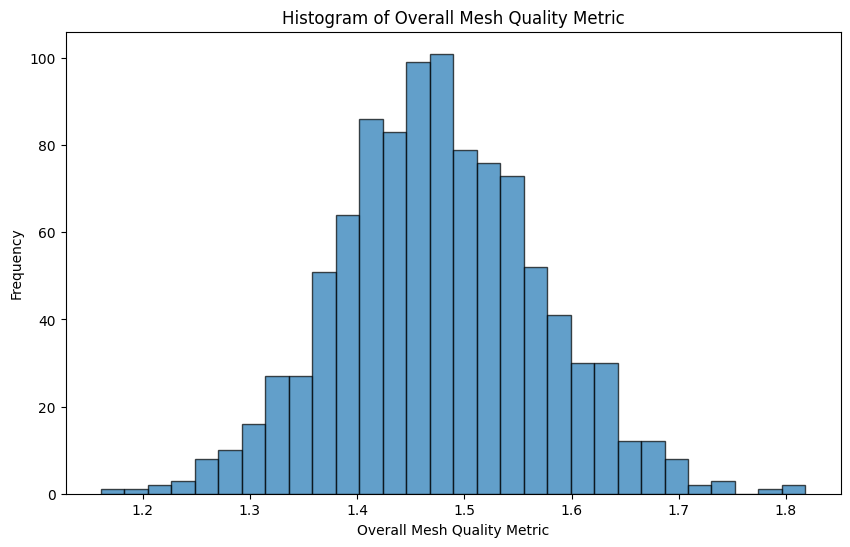

In [71]:
# Function to compute mesh quality
def compute_mesh_quality(mesh):
    qualities = {}

    def edge_lengths(elements):
        lengths = []
        for element in elements:
            edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
            lengths.append(edges)
        return np.array(lengths)

    lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # Aspect Ratio: ratio of longest to shortest edge in each element
    aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    qualities['aspect_ratios'] = aspect_ratios

    # Non-Orthogonality: deviation from orthogonal angles in radians
    def non_orthogonality(elements):
        orthogonality = []
        for element in elements:
            element_orthogonality = []
            for i in range(len(element)):
                a = element[i]
                b = element[(i+1) % len(element)]
                c = element[(i+2) % len(element)]
                ba = b - a
                bc = b - c
                angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
                # element_orthogonality.append(np.pi / 2 - angle)
            orthogonality.append(np.pi / 2 - angle)
        return np.array(orthogonality)
    
    qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
    areas = mesh.area_faces
    volume_ratio = areas / np.mean(areas)
    qualities['volume_ratio'] = volume_ratio

    # Using trimesh's face_angles property to calculate angles
    face_angles = mesh.face_angles  # <-- Here is the built-in property usage

    # Convert angles from radians to degrees for skewness calculation
    face_angles_degrees = np.degrees(face_angles)
    
    # Skewness: deviation from ideal angles
    ideal_angle_tri = 60
    skewness_tri = np.max(np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri, axis=1)
    qualities['skewness'] = skewness_tri

    # Tri Max Angle: maximum angle in each triangle
    tri_max_angle = np.max(face_angles_degrees, axis=1)
    qualities['tri_max_angle'] = tri_max_angle

    # Tri Min Angle: minimum angle in each triangle
    tri_min_angle = np.min(face_angles_degrees, axis=1)
    qualities['tri_min_angle'] = tri_min_angle

    return qualities

# Define volume function
def volume(mesh):
    return mesh.volume if mesh.is_volume else 0

# Define non-degenerate faces function
def nondegenerate_faces(mesh, threshold=1e-6):
    return mesh.area_faces > threshold

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

# Function to compute statistical metrics
def compute_statistics(quality_array):
    stats = {}
    stats['min'] = np.min(quality_array)
    stats['max'] = np.max(quality_array)
    stats['mean'] = np.mean(quality_array)
    stats['std'] = np.std(quality_array)
    stats['median'] = np.median(quality_array)
    stats['99.9th_percentile'] = np.percentile(quality_array, 99.9)
    return stats

# Compute statistics for each quality metric
statistics = {metric: compute_statistics(quality_metrics[metric]) for metric in quality_metrics}

# Define an overall mesh quality metric
def overall_quality_metric(stats):
    overall_quality = 0
    for metric in stats:
        overall_quality += 1 / (1 + stats[metric]['mean'] + stats[metric]['std'])
    return overall_quality

overall_quality = overall_quality_metric(statistics)

# Print the overall mesh quality metric
print(f"Overall Mesh Quality Metric: {overall_quality}")

# Plot histogram for the overall mesh quality metric
def plot_overall_quality_histogram(overall_quality):
    plt.figure(figsize=(10, 6))
    plt.hist(overall_quality, bins=30, edgecolor='k', alpha=0.7)
    plt.title("Histogram of Overall Mesh Quality Metric")
    plt.xlabel("Overall Mesh Quality Metric")
    plt.ylabel("Frequency")
    plt.show()

# Simulate a distribution of the overall quality metric
overall_quality_samples = np.random.normal(overall_quality, 0.1, 1000)

# Call the function to plot the histogram
plot_overall_quality_histogram(overall_quality_samples)


# Gambier

In [73]:
# Load the image and reshape it into a 3D array
img = np.fromfile("segmented_gambier_512.ubc", dtype=np.uint8).reshape((512, 512, 512))

# Slice the image
resized_img = img[:100, :100, :100]  

# def sdt(image) -> np.ndarray:
#     """
#     Returns Signed distance transform map of the input image
#     """
#     pore = edt(image)
#     image = np.invert(image * 255)
#     grain = -1 * edt(image)
#     sample = grain + pore

#     return sample
    
# # Plot isosurface on resized image
# def plot_isosurface(data, fig: pv.Plotter = None, show_isosurface: list = None, mesh_kwargs: dict = None,
#                     plotter_kwargs: dict = None) -> pv.Plotter:
#     if mesh_kwargs is None:
#         mesh_kwargs = {'opacity': 0.45, 'smooth_shading': True, 'diffuse': 0.75, 'color': (77 / 255, 195 / 255, 255 / 255), 'ambient': 0.15}

#     if plotter_kwargs is None:
#         plotter_kwargs = {}

#     if fig is None:
#         fig = pv.Plotter(**plotter_kwargs)

#     pv_image_obj = pv.wrap(data)

#     if show_isosurface is None:
#         show_isosurface = [0]

#     contours = pv_image_obj.contour(isosurfaces=show_isosurface)
#     fig.add_mesh(contours, **mesh_kwargs)
#     return contours, fig
    
resized_img = sdt(resized_img)
resized_img = 2 * (resized_img - np.amin(resized_img)) / (np.amax(resized_img) - np.amin(resized_img)) - 1

# Generate the isosurface from the resized image
contour, plotter = plot_isosurface(resized_img, show_isosurface=[0])

# Extract surface and triangulate
mesh = contour.extract_surface().triangulate()

# Extract faces and create Trimesh object
n_faces = mesh.n_cells
faces_as_array = mesh.faces.reshape((n_faces, 4))[:, 1:]
tmesh = trimesh.Trimesh(mesh.points, faces_as_array)

# Visualize with Trimesh
tmesh.show()

In [74]:
# Function to compute mesh quality
# def compute_mesh_quality(mesh):
#     qualities = {}

    # def edge_lengths(elements):
    #     lengths = []
    #     for element in elements:
    #         edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
    #         lengths.append(edges)
    #     return np.array(lengths)

    # lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # # Aspect Ratio: ratio of longest to shortest edge in each element
    # aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    # qualities['aspect_ratios'] = aspect_ratios

    # # Non-Orthogonality: deviation from orthogonal angles in radians
    # def non_orthogonality(elements):
    #     orthogonality = []
    #     for element in elements:
    #         element_orthogonality = []
    #         for i in range(len(element)):
    #             a = element[i]
    #             b = element[(i+1) % len(element)]
    #             c = element[(i+2) % len(element)]
    #             ba = b - a
    #             bc = b - c
    #             angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
    #             element_orthogonality.append(np.pi / 2 - angle)
    #         orthogonality.append(element_orthogonality)
    #     return np.array(orthogonality)
    
    # qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
#     areas = mesh.area_faces
#     volume_ratio = areas / np.mean(areas)
#     qualities['volume_ratio'] = volume_ratio

#     # Using trimesh's face_angles property to calculate angles
#     face_angles = mesh.face_angles  # <-- Here is the built-in property usage

#     # Convert angles from radians to degrees for skewness calculation
#     face_angles_degrees = np.degrees(face_angles)
    
#     # Skewness: deviation from ideal angles
#     ideal_angle_tri = 60
#     skewness_tri = np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri
#     qualities['skewness'] = skewness_tri

#     # Tri Max Angle: maximum angle in each triangle
#     tri_max_angle = np.max(face_angles_degrees, axis=1)
#     qualities['tri_max_angle'] = tri_max_angle

#     # Tri Min Angle: minimum angle in each triangle
#     tri_min_angle = np.min(face_angles_degrees, axis=1)
#     qualities['tri_min_angle'] = tri_min_angle

#     return qualities

# # Define volume function
# def volume(mesh):
#     return mesh.volume if mesh.is_volume else 0

# # Define non-degenerate faces function
# def nondegenerate_faces(mesh, threshold=1e-6):
#     return mesh.area_faces > threshold

# Print volume and non-degenerate faces count
print(f"Volume of the mesh: {volume(tmesh)}")
print(f"Number of non-degenerate faces: {np.sum(nondegenerate_faces(tmesh))}")

# Print statistics and overall quality
print(f"Number of elements (triangles): {tmesh.faces.shape[0]}")

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

print(f"Aspect Ratios: min={np.min(quality_metrics['aspect_ratios'])}, max={np.max(quality_metrics['aspect_ratios'])}, mean={np.mean(quality_metrics['aspect_ratios'])}")
print(f"Non-Orthogonality: min={np.min(quality_metrics['non_orthogonality'])}, max={np.max(quality_metrics['non_orthogonality'])}, mean={np.mean(quality_metrics['non_orthogonality'])}")
print(f"Volume Ratio: min={np.min(quality_metrics['volume_ratio'])}, max={np.max(quality_metrics['volume_ratio'])}, mean={np.mean(quality_metrics['volume_ratio'])}")
print(f"Skewness: min={np.min(quality_metrics['skewness'])}, max={np.max(quality_metrics['skewness'])}, mean={np.mean(quality_metrics['skewness'])}")
print(f"Tri Max Angle: min={np.min(quality_metrics['tri_max_angle'])}, max={np.max(quality_metrics['tri_max_angle'])}, mean={np.mean(quality_metrics['tri_max_angle'])}")
print(f"Tri Min Angle: min={np.min(quality_metrics['tri_min_angle'])}, max={np.max(quality_metrics['tri_min_angle'])}, mean={np.mean(quality_metrics['tri_min_angle'])}")

Volume of the mesh: 0
Number of non-degenerate faces: 262080
Number of elements (triangles): 262080
Aspect Ratios: min=1.0, max=12.108632498830632, mean=2.6535897340205055
Non-Orthogonality: min=-1.0215111742372, max=1.495958278858003, mean=0.514194975345133
Volume Ratio: min=0.016835660152094624, max=2.241858622810885, mean=1.0000000000000004
Skewness: min=2.3684757858670006e-16, max=1.5801240138451484, mean=0.5713590642014761
Tri Max Angle: min=60.00000000000001, max=154.8074408307089, mean=92.6073847463357
Tri Min Angle: min=4.287904293781622, max=59.99999999999999, mean=34.30461369743543


In [75]:
# Call the function to plot histograms
#plot_histograms(quality_metrics)

Overall Mesh Quality Metric: 1.6224804997292541


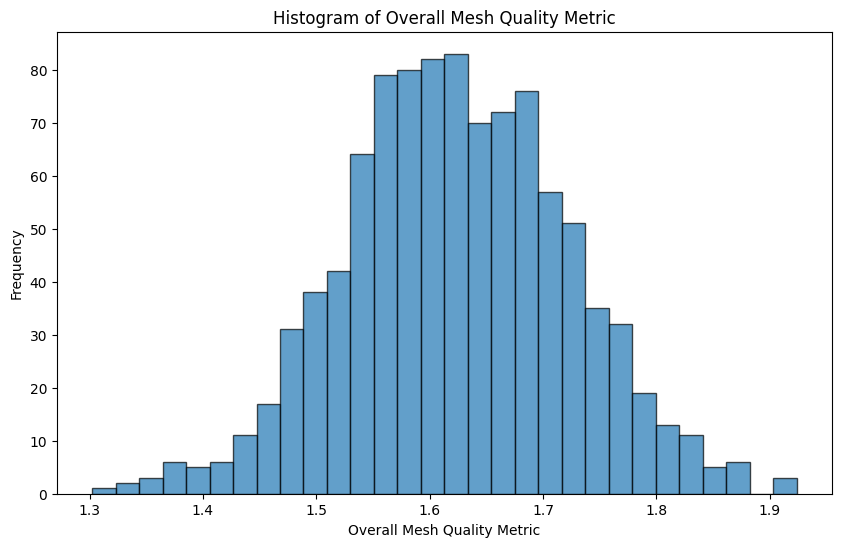

In [76]:
# Function to compute mesh quality
def compute_mesh_quality(mesh):
    qualities = {}

    def edge_lengths(elements):
        lengths = []
        for element in elements:
            edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
            lengths.append(edges)
        return np.array(lengths)

    lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # Aspect Ratio: ratio of longest to shortest edge in each element
    aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    qualities['aspect_ratios'] = aspect_ratios

    # Non-Orthogonality: deviation from orthogonal angles in radians
    def non_orthogonality(elements):
        orthogonality = []
        for element in elements:
            element_orthogonality = []
            for i in range(len(element)):
                a = element[i]
                b = element[(i+1) % len(element)]
                c = element[(i+2) % len(element)]
                ba = b - a
                bc = b - c
                angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
                # element_orthogonality.append(np.pi / 2 - angle)
            orthogonality.append(np.pi / 2 - angle)
        return np.array(orthogonality)
    
    qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
    areas = mesh.area_faces
    volume_ratio = areas / np.mean(areas)
    qualities['volume_ratio'] = volume_ratio

    # Using trimesh's face_angles property to calculate angles
    face_angles = mesh.face_angles  # <-- Here is the built-in property usage

    # Convert angles from radians to degrees for skewness calculation
    face_angles_degrees = np.degrees(face_angles)
    
    # Skewness: deviation from ideal angles
    ideal_angle_tri = 60
    skewness_tri = np.max(np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri, axis=1)
    qualities['skewness'] = skewness_tri

    # Tri Max Angle: maximum angle in each triangle
    tri_max_angle = np.max(face_angles_degrees, axis=1)
    qualities['tri_max_angle'] = tri_max_angle

    # Tri Min Angle: minimum angle in each triangle
    tri_min_angle = np.min(face_angles_degrees, axis=1)
    qualities['tri_min_angle'] = tri_min_angle

    return qualities

# Define volume function
def volume(mesh):
    return mesh.volume if mesh.is_volume else 0

# Define non-degenerate faces function
def nondegenerate_faces(mesh, threshold=1e-6):
    return mesh.area_faces > threshold

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

# Function to compute statistical metrics
def compute_statistics(quality_array):
    stats = {}
    stats['min'] = np.min(quality_array)
    stats['max'] = np.max(quality_array)
    stats['mean'] = np.mean(quality_array)
    stats['std'] = np.std(quality_array)
    stats['median'] = np.median(quality_array)
    stats['99.9th_percentile'] = np.percentile(quality_array, 99.9)
    return stats

# Compute statistics for each quality metric
statistics = {metric: compute_statistics(quality_metrics[metric]) for metric in quality_metrics}

# Define an overall mesh quality metric
def overall_quality_metric(stats):
    overall_quality = 0
    for metric in stats:
        overall_quality += 1 / (1 + stats[metric]['mean'] + stats[metric]['std'])
    return overall_quality

overall_quality = overall_quality_metric(statistics)

# Print the overall mesh quality metric
print(f"Overall Mesh Quality Metric: {overall_quality}")

# Plot histogram for the overall mesh quality metric
def plot_overall_quality_histogram(overall_quality):
    plt.figure(figsize=(10, 6))
    plt.hist(overall_quality, bins=30, edgecolor='k', alpha=0.7)
    plt.title("Histogram of Overall Mesh Quality Metric")
    plt.xlabel("Overall Mesh Quality Metric")
    plt.ylabel("Frequency")
    plt.show()

# Simulate a distribution of the overall quality metric
overall_quality_samples = np.random.normal(overall_quality, 0.1, 1000)

# Call the function to plot the histogram
plot_overall_quality_histogram(overall_quality_samples)


# Bead Pack

In [78]:
# Load the image and reshape it into a 3D array
img = np.fromfile("segmented_bead_pack_512.ubc", dtype=np.uint8).reshape((512, 512, 512))

# Slice the image
resized_img = img[:100, :100, :100]  

# def sdt(image) -> np.ndarray:
#     """
#     Returns Signed distance transform map of the input image
#     """
#     pore = edt(image)
#     image = np.invert(image * 255)
#     grain = -1 * edt(image)
#     sample = grain + pore

#     return sample
    
# # Plot isosurface on resized image
# def plot_isosurface(data, fig: pv.Plotter = None, show_isosurface: list = None, mesh_kwargs: dict = None,
#                     plotter_kwargs: dict = None) -> pv.Plotter:
#     if mesh_kwargs is None:
#         mesh_kwargs = {'opacity': 0.45, 'smooth_shading': True, 'diffuse': 0.75, 'color': (77 / 255, 195 / 255, 255 / 255), 'ambient': 0.15}

#     if plotter_kwargs is None:
#         plotter_kwargs = {}

#     if fig is None:
#         fig = pv.Plotter(**plotter_kwargs)

#     pv_image_obj = pv.wrap(data)

#     if show_isosurface is None:
#         show_isosurface = [0]

#     contours = pv_image_obj.contour(isosurfaces=show_isosurface)
#     fig.add_mesh(contours, **mesh_kwargs)
#     return contours, fig
    
resized_img = sdt(resized_img)
resized_img = 2 * (resized_img - np.amin(resized_img)) / (np.amax(resized_img) - np.amin(resized_img)) - 1

# Generate the isosurface from the resized image
contour, plotter = plot_isosurface(resized_img, show_isosurface=[0])

# Extract surface and triangulate
mesh = contour.extract_surface().triangulate()

# Extract faces and create Trimesh object
n_faces = mesh.n_cells
faces_as_array = mesh.faces.reshape((n_faces, 4))[:, 1:]
tmesh = trimesh.Trimesh(mesh.points, faces_as_array)

# Visualize with Trimesh
tmesh.show()

In [79]:
# Function to compute mesh quality
# def compute_mesh_quality(mesh):
#     qualities = {}

    # def edge_lengths(elements):
    #     lengths = []
    #     for element in elements:
    #         edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
    #         lengths.append(edges)
    #     return np.array(lengths)

    # lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # # Aspect Ratio: ratio of longest to shortest edge in each element
    # aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    # qualities['aspect_ratios'] = aspect_ratios

    # # Non-Orthogonality: deviation from orthogonal angles in radians
    # def non_orthogonality(elements):
    #     orthogonality = []
    #     for element in elements:
    #         element_orthogonality = []
    #         for i in range(len(element)):
    #             a = element[i]
    #             b = element[(i+1) % len(element)]
    #             c = element[(i+2) % len(element)]
    #             ba = b - a
    #             bc = b - c
    #             angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
    #             element_orthogonality.append(np.pi / 2 - angle)
    #         orthogonality.append(element_orthogonality)
    #     return np.array(orthogonality)
    
    # qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
#     areas = mesh.area_faces
#     volume_ratio = areas / np.mean(areas)
#     qualities['volume_ratio'] = volume_ratio

#     # Using trimesh's face_angles property to calculate angles
#     face_angles = mesh.face_angles  # <-- Here is the built-in property usage

#     # Convert angles from radians to degrees for skewness calculation
#     face_angles_degrees = np.degrees(face_angles)
    
#     # Skewness: deviation from ideal angles
#     ideal_angle_tri = 60
#     skewness_tri = np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri
#     qualities['skewness'] = skewness_tri

#     # Tri Max Angle: maximum angle in each triangle
#     tri_max_angle = np.max(face_angles_degrees, axis=1)
#     qualities['tri_max_angle'] = tri_max_angle

#     # Tri Min Angle: minimum angle in each triangle
#     tri_min_angle = np.min(face_angles_degrees, axis=1)
#     qualities['tri_min_angle'] = tri_min_angle

#     return qualities

# # Define volume function
# def volume(mesh):
#     return mesh.volume if mesh.is_volume else 0

# # Define non-degenerate faces function
# def nondegenerate_faces(mesh, threshold=1e-6):
#     return mesh.area_faces > threshold

# Print volume and non-degenerate faces count
print(f"Volume of the mesh: {volume(tmesh)}")
print(f"Number of non-degenerate faces: {np.sum(nondegenerate_faces(tmesh))}")

# Print statistics and overall quality
print(f"Number of elements (triangles): {tmesh.faces.shape[0]}")

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

print(f"Aspect Ratios: min={np.min(quality_metrics['aspect_ratios'])}, max={np.max(quality_metrics['aspect_ratios'])}, mean={np.mean(quality_metrics['aspect_ratios'])}")
print(f"Non-Orthogonality: min={np.min(quality_metrics['non_orthogonality'])}, max={np.max(quality_metrics['non_orthogonality'])}, mean={np.mean(quality_metrics['non_orthogonality'])}")
print(f"Volume Ratio: min={np.min(quality_metrics['volume_ratio'])}, max={np.max(quality_metrics['volume_ratio'])}, mean={np.mean(quality_metrics['volume_ratio'])}")
print(f"Skewness: min={np.min(quality_metrics['skewness'])}, max={np.max(quality_metrics['skewness'])}, mean={np.mean(quality_metrics['skewness'])}")
print(f"Tri Max Angle: min={np.min(quality_metrics['tri_max_angle'])}, max={np.max(quality_metrics['tri_max_angle'])}, mean={np.mean(quality_metrics['tri_max_angle'])}")
print(f"Tri Min Angle: min={np.min(quality_metrics['tri_min_angle'])}, max={np.max(quality_metrics['tri_min_angle'])}, mean={np.mean(quality_metrics['tri_min_angle'])}")

Volume of the mesh: 0
Number of non-degenerate faces: 92921
Number of elements (triangles): 92921
Aspect Ratios: min=1.0, max=20.934537434186456, mean=4.2015364234622306
Non-Orthogonality: min=-1.076451997945099, max=1.531322205652793, mean=0.5307724117781843
Volume Ratio: min=0.015700334344731993, max=2.358931062832605, mean=1.0000000000000002
Skewness: min=2.3684757858670006e-16, max=1.6511659641333756, mean=0.6515495361373052
Tri Max Angle: min=60.00000000000001, max=159.06995784800253, mean=94.70935125033245
Tri Min Angle: min=2.261700541430643, max=59.99999999999999, mean=30.037638082710465


In [80]:
# Call the function to plot histograms
#plot_histograms(quality_metrics)

Overall Mesh Quality Metric: 1.4791428837045493


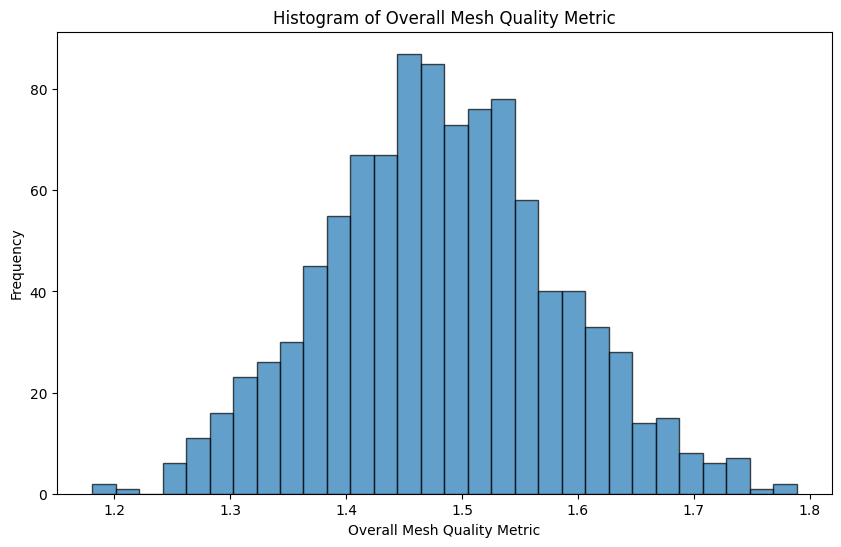

In [81]:
# Function to compute mesh quality
def compute_mesh_quality(mesh):
    qualities = {}

    def edge_lengths(elements):
        lengths = []
        for element in elements:
            edges = [np.linalg.norm(element[(i+1)%len(element)] - element[i]) for i in range(len(element))]
            lengths.append(edges)
        return np.array(lengths)

    lengths = edge_lengths(mesh.vertices[mesh.faces])
    
    # Aspect Ratio: ratio of longest to shortest edge in each element
    aspect_ratios = np.max(lengths, axis=1) / np.min(lengths, axis=1)
    qualities['aspect_ratios'] = aspect_ratios

    # Non-Orthogonality: deviation from orthogonal angles in radians
    def non_orthogonality(elements):
        orthogonality = []
        for element in elements:
            element_orthogonality = []
            for i in range(len(element)):
                a = element[i]
                b = element[(i+1) % len(element)]
                c = element[(i+2) % len(element)]
                ba = b - a
                bc = b - c
                angle = np.arccos(np.dot(ba, bc) / (np.linalg.norm(ba) * np.linalg.norm(bc)))
                # element_orthogonality.append(np.pi / 2 - angle)
            orthogonality.append(np.pi / 2 - angle)
        return np.array(orthogonality)
    
    qualities['non_orthogonality'] = non_orthogonality(mesh.vertices[mesh.faces])

    # Volume Ratio: area ratio for 2D meshes, volume ratio for 3D
    areas = mesh.area_faces
    volume_ratio = areas / np.mean(areas)
    qualities['volume_ratio'] = volume_ratio

    # Using trimesh's face_angles property to calculate angles
    face_angles = mesh.face_angles  # <-- Here is the built-in property usage

    # Convert angles from radians to degrees for skewness calculation
    face_angles_degrees = np.degrees(face_angles)
    
    # Skewness: deviation from ideal angles
    ideal_angle_tri = 60
    skewness_tri = np.max(np.abs(face_angles_degrees - ideal_angle_tri) / ideal_angle_tri, axis=1)
    qualities['skewness'] = skewness_tri

    # Tri Max Angle: maximum angle in each triangle
    tri_max_angle = np.max(face_angles_degrees, axis=1)
    qualities['tri_max_angle'] = tri_max_angle

    # Tri Min Angle: minimum angle in each triangle
    tri_min_angle = np.min(face_angles_degrees, axis=1)
    qualities['tri_min_angle'] = tri_min_angle

    return qualities

# Define volume function
def volume(mesh):
    return mesh.volume if mesh.is_volume else 0

# Define non-degenerate faces function
def nondegenerate_faces(mesh, threshold=1e-6):
    return mesh.area_faces > threshold

# Compute and print mesh quality metrics
quality_metrics = compute_mesh_quality(tmesh)

# Function to compute statistical metrics
def compute_statistics(quality_array):
    stats = {}
    stats['min'] = np.min(quality_array)
    stats['max'] = np.max(quality_array)
    stats['mean'] = np.mean(quality_array)
    stats['std'] = np.std(quality_array)
    stats['median'] = np.median(quality_array)
    stats['99.9th_percentile'] = np.percentile(quality_array, 99.9)
    return stats

# Compute statistics for each quality metric
statistics = {metric: compute_statistics(quality_metrics[metric]) for metric in quality_metrics}

# Define an overall mesh quality metric
def overall_quality_metric(stats):
    overall_quality = 0
    for metric in stats:
        overall_quality += 1 / (1 + stats[metric]['mean'] + stats[metric]['std'])
    return overall_quality

overall_quality = overall_quality_metric(statistics)

# Print the overall mesh quality metric
print(f"Overall Mesh Quality Metric: {overall_quality}")

# Plot histogram for the overall mesh quality metric
def plot_overall_quality_histogram(overall_quality):
    plt.figure(figsize=(10, 6))
    plt.hist(overall_quality, bins=30, edgecolor='k', alpha=0.7)
    plt.title("Histogram of Overall Mesh Quality Metric")
    plt.xlabel("Overall Mesh Quality Metric")
    plt.ylabel("Frequency")
    plt.show()

# Simulate a distribution of the overall quality metric
overall_quality_samples = np.random.normal(overall_quality, 0.1, 1000)

# Call the function to plot the histogram
plot_overall_quality_histogram(overall_quality_samples)
